In [1]:
import pandas as pd 
from prophet import Prophet 
from prophet.plot import plot_plotly, plot_components_plotly

In [2]:
df = pd.read_csv('final_time_series_data2.csv')
df.head()

,Unnamed: 0,Date,values,prod
0,0,1/1/21 0:00,2.301128,prod1
1,1,1/1/21 0:01,1.100027,prod1
2,2,1/1/21 0:02,0.746019,prod1
3,3,1/1/21 0:03,0.995015,prod1
4,4,1/1/21 0:04,2.408273,prod1


In [3]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49999 entries, 0 to 49998
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  49999 non-null  int64  
 1   Date        49999 non-null  object 
 2   values      49999 non-null  float64
 3   prod        49999 non-null  object 
dtypes: float64(1), int64(1), object(2)
memory usage: 1.5+ MB


In [4]:
df = df[["Date","values"]]
df.columns= ['ds','y']
df.head()

,ds,y
0,1/1/21 0:00,2.301128
1,1/1/21 0:01,1.100027
2,1/1/21 0:02,0.746019
3,1/1/21 0:03,0.995015
4,1/1/21 0:04,2.408273


In [5]:
train = df.iloc[:len(df)-365]
test = df.iloc[len(df)-365:]

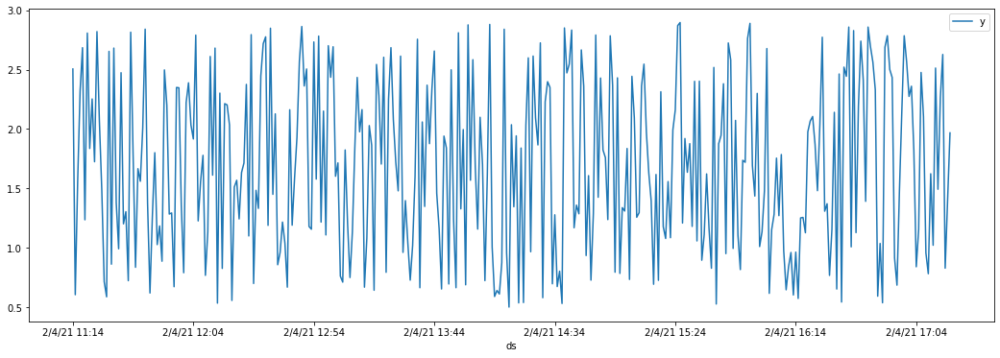

In [6]:
test.plot(x='ds', y='y', figsize=(18,6))

In [7]:
m = Prophet()
m.fit(train)
future = m.make_future_dataframe(periods=180)
foreacst = m.predict(future)

18:35:14 - cmdstanpy - INFO - Chain [1] start processing
18:35:23 - cmdstanpy - INFO - Chain [1] done processing


In [8]:
foreacst.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
49809,2021-07-30 11:13:00,1.791513,0.976461,2.703111,1.772874,1.809328,0.029007,0.029007,0.029007,0.018538,0.018538,0.018538,0.010469,0.010469,0.010469,0.0,0.0,0.0,1.820520
49810,2021-07-31 11:13:00,1.791985,0.977949,2.722172,1.773247,1.810058,0.010928,0.010928,0.010928,0.018538,0.018538,0.018538,-0.007611,-0.007611,-0.007611,0.0,0.0,0.0,1.802912
49811,2021-08-01 11:13:00,1.792456,0.897435,2.697203,1.773561,1.810768,0.017283,0.017283,0.017283,0.018538,0.018538,0.018538,-0.001255,-0.001255,-0.001255,0.0,0.0,0.0,1.809739
49812,2021-08-02 11:13:00,1.792928,0.914535,2.691593,1.773777,1.811457,0.015094,0.015094,0.015094,0.018538,0.018538,0.018538,-0.003444,-0.003444,-0.003444,0.0,0.0,0.0,1.808022
49813,2021-08-03 11:13:00,1.793399,0.992888,2.649341,1.774082,1.812110,0.014472,0.014472,0.014472,0.018538,0.018538,0.018538,-0.004067,-0.004067,-0.004067,0.0,0.0,0.0,1.807871


In [9]:
foreacst[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
49809,2021-07-30 11:13:00,1.820520,0.976461,2.703111
49810,2021-07-31 11:13:00,1.802912,0.977949,2.722172
49811,2021-08-01 11:13:00,1.809739,0.897435,2.697203
49812,2021-08-02 11:13:00,1.808022,0.914535,2.691593
49813,2021-08-03 11:13:00,1.807871,0.992888,2.649341


/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/site-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/site-packages/matplotlib/axes/_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


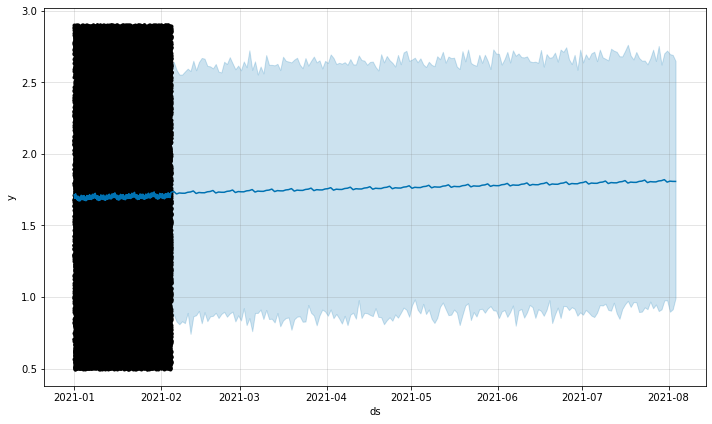

In [10]:
fig1= m.plot(foreacst)

/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/site-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/site-packages/matplotlib/axes/_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]
/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/site-packages/matplotlib/cbook/__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x[:, None]
/Users/basitnadeem/opt/miniconda3/envs/minimal_ds/lib/python3.10/sit

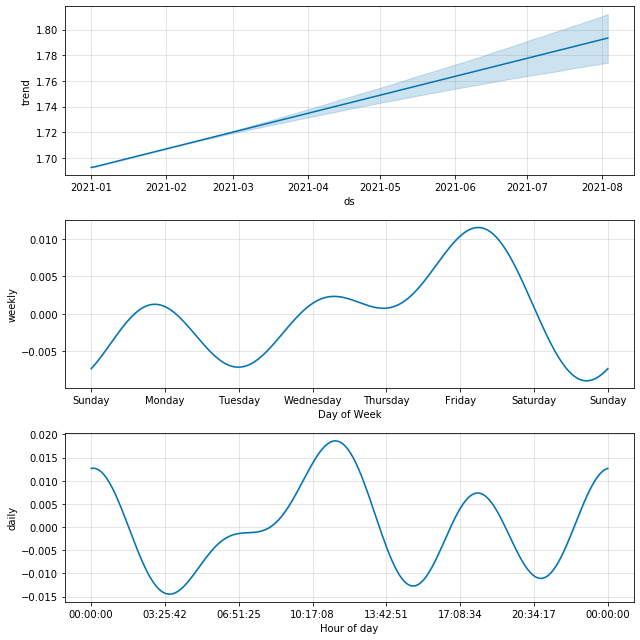

In [11]:
fig2=m.plot_components(foreacst)

In [14]:
plot_plotly(m,foreacst)

In [15]:
plot_components_plotly(m, foreacst)

In [17]:
from statsmodels.tools.eval_measures import rmse
predictions = foreacst.iloc[-365:]['yhat']

print("RMSE b/w actual and predicted values:", rmse(predictions, test['y']))
print("Mean value of test dataset:", test['y'].mean())

RMSE b/w actual and predicted values: 0.7199756645999461
Mean value of test dataset: 1.6875081877397256


In [18]:
from prophet.serialize import model_to_json, model_from_json
with open('test-model.json', 'w') as fout:
    fout.write(model_to_json(m))  # Save model